In [1]:
import Pkg; Pkg.add(["Plots","Interact"]);
import Logging; Logging.disable_logging(Logging.Info)

    Updating registry at `~/.julia/registries/General.toml`
   Resolving package versions...
  No Changes to `~/Desktop/个人/CSE 6643 Numerical Linear Algebra/Lecture/Project.toml`
  No Changes to `~/Desktop/个人/CSE 6643 Numerical Linear Algebra/Lecture/Manifest.toml`


LogLevel(1)

In [2]:
const STATIC_LECTURE = false;

In [3]:
using LinearAlgebra;
using Plots; gr(); default(l=5, size=(900,550), label=false);
using Printf;
using Interact;

BLAS.set_num_threads(1)

if STATIC_LECTURE
    default(fmt=:png)
    macro manipulate(v)
        return :($v; plot!())
    end
end

prettyprint(a) = map(x -> @sprintf("%+.2f", x), a)
sciprint(a) = map(x -> @sprintf("%+.2e", x), a)

function imshow(x; kwargs...)
    return heatmap(x
        , aspect_ratio=:equal
        , framestyle=:none
        , yflip=true
        , c=cgrad(:linear_worb_100_25_c53_n256)
        ; kwargs...
    )
end
bigspy(x; kwargs...) = spy(x, m=4, c=:diverging_gwv_55_95_c39_n256; kwargs...)
p = plot!([0,1],[0,1]);

WebIO._IJuliaInit()

# The QR Algorithm

## QR Demonstration

### Aside: anti-credentialism

- One of the originators of the QR algorithm in 1961, J.G.F. Francis, did not complete his degree

### Basic QR Algorithm

In [4]:
A = randn(m,m);

LoadError: UndefVarError: m not defined

In [5]:
A⁽ⁱ⁾ = copy(A)

for i in 1:n_iter
    Q⁽ⁱ⁾, R⁽ⁱ⁾ = qr(A⁽ⁱ⁾)
    A⁽ⁱ⁾ = R⁽ⁱ⁾ * Q⁽ⁱ⁾
end

LoadError: UndefVarError: A not defined

Plots.AnimatedGif("/Users/lzs/Desktop/个人/CSE 6643 Numerical Linear Algebra/Lecture/QR_demo_1.gif")
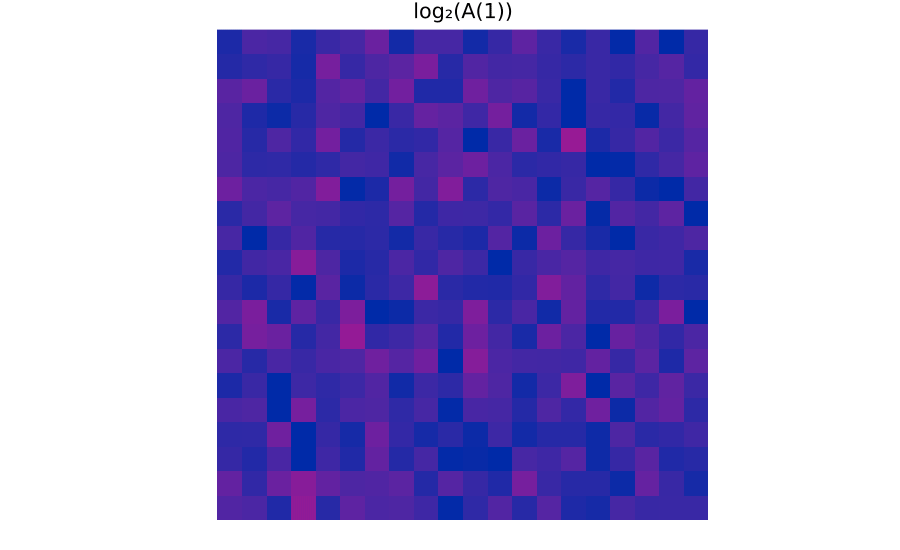

In [6]:
m = 20
A = randn(m,m)
n_iter = 200
Aᵢ = copy(A)
anim = Animation()

for i in 1:n_iter
    frame(anim,imshow(log2.(max.(abs.(Aᵢ), eps())), clim=(log2(eps()),1), colorbar=false, title="log₂(A($i))"))
    Q, R = qr(Aᵢ)
    Aᵢ = R * Q
end
gif(anim, "QR_demo_1.gif", fps=4)

### Same thing, but $A$ is hermitian

Plots.AnimatedGif("/Users/lzs/Desktop/个人/CSE 6643 Numerical Linear Algebra/Lecture/QR_demo_2.gif")
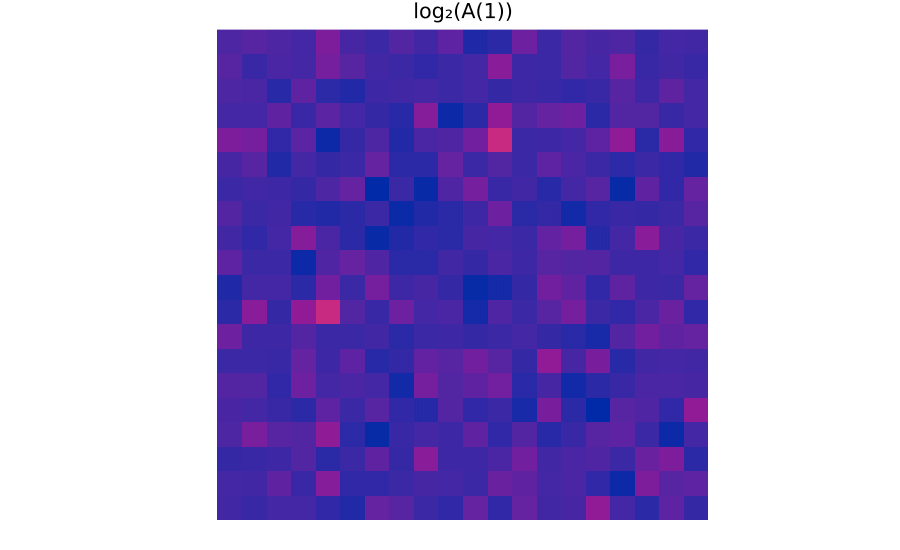

In [7]:
m = 20
A = randn(m,m)
A = 0.5*(A + A')
n_iter = 200
Aᵢ = copy(A)
anim = Animation()

for i in 1:n_iter
    frame(anim,imshow(log2.(max.(abs.(Aᵢ), eps())), clim=(log2(eps()),1), colorbar=false, title="log₂(A($i))"))
    Q, R = qr(Aᵢ)
    Aᵢ = R * Q
end
gif(anim, "QR_demo_2.gif", fps=4)

### A better starting point: upper Hessenberg form

In [8]:
A⁽ⁱ⁾ = hessenberg(A).H

for i in 1:n_iter
    Q⁽ⁱ⁾, R⁽ⁱ⁾ = qr(A⁽ⁱ⁾)
    A⁽ⁱ⁾ = R⁽ⁱ⁾ * Q⁽ⁱ⁾
end

Plots.AnimatedGif("/Users/lzs/Desktop/个人/CSE 6643 Numerical Linear Algebra/Lecture/QR_demo_3.gif")
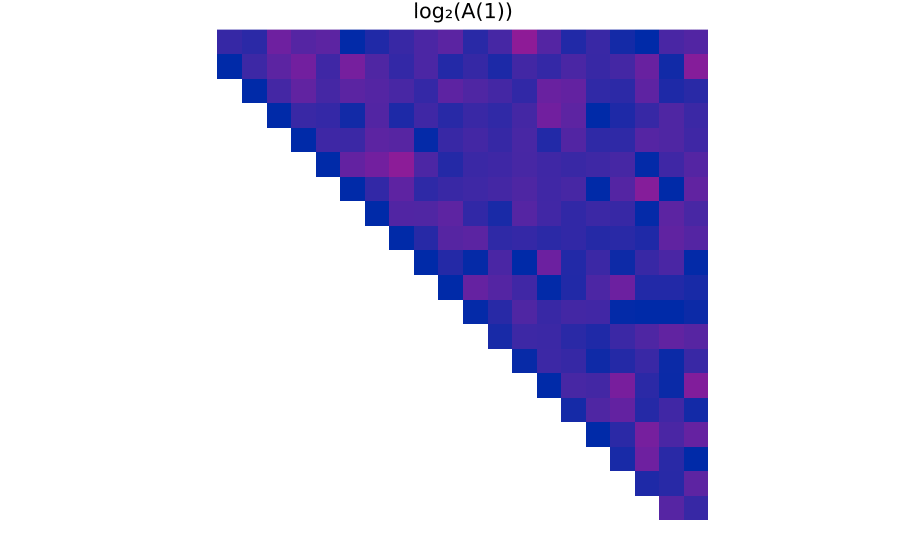

In [9]:
m = 20
A = randn(m,m)
n_iter = 200
Aᵢ = hessenberg(A).H
anim = Animation()

for i in 1:n_iter
    frame(anim,imshow(log2.(max.(abs.(Aᵢ), eps())), clim=(log2(eps()),1), colorbar=false, title="log₂(A($i))"))
    Q, R = qr(Aᵢ)
    Aᵢ = R * Q
end
gif(anim, "QR_demo_3.gif", fps=4)

Plots.AnimatedGif("/Users/lzs/Desktop/个人/CSE 6643 Numerical Linear Algebra/Lecture/QR_demo_4.gif")
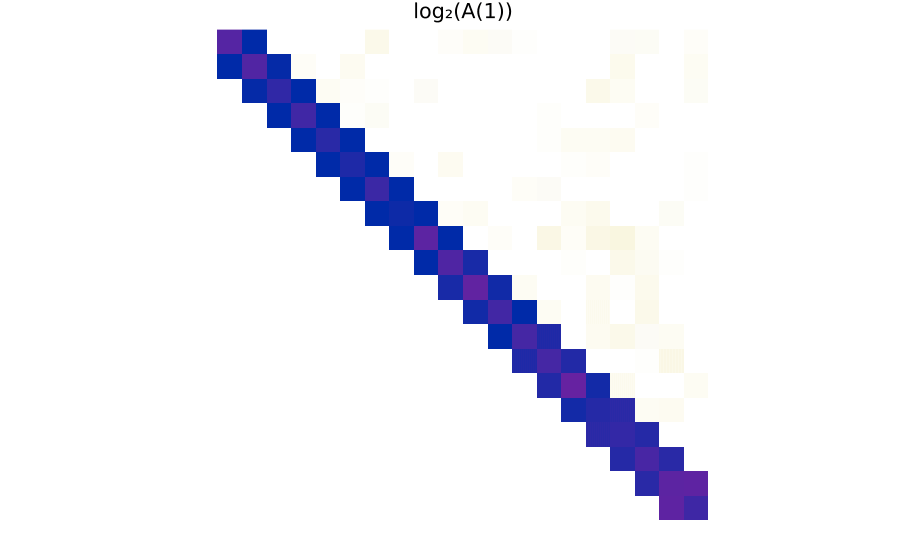

In [10]:
m = 20
A = randn(m,m)
A = 0.5*(A + A')
n_iter = 200
Aᵢ = hessenberg(A).H
anim = Animation()

for i in 1:n_iter
    frame(anim,imshow(log2.(max.(abs.(Aᵢ), eps())), clim=(log2(eps()),1), colorbar=false, title="log₂(A($i))"))
    Q, R = qr(Aᵢ)
    Aᵢ = Matrix(Tridiagonal(R * Q))
end
gif(anim, "QR_demo_4.gif", fps=4)

## Recall: Rayleigh Quotient Iteration

1. Use the $r(v)$ to get a good estimate $\mu \approx \lambda_J$
2. Use power iteration with $(A - \mu I)^{-1}$ to get a better estimate of $q_J$
3. Repeat

In [11]:
function rayleigh_quotient_iteration(A, v⁰ = randn(size(A)[1]), n_iter = size(A)[1])
    v = copy(v⁰) / norm(v⁰)
    w = copy(v)
    λ = v' * A  * v
    for k in 1:n_iter
        try
            w = (A - λ * I) \ v # Shifted inverse power iteration
        catch e
            if isa(e, SingularException) # Matrix is singular: converged
                return (λ, v)
            else
                throw(e)
            end
        end
        v = w / norm(w)
        λ = v' * A * v # ← Rayleigh quotient (because v' * v = 1)
    end
    return (λ, v)
end

rayleigh_quotient_iteration (generic function with 3 methods)

### Introduce Shifts

In [12]:
A⁽ⁱ⁾ = hessenberg(A).H
tol = 2 * eps()
for i in 1:n_iter
    μ = A⁽ⁱ⁾[m,m] # Rayleigh quotient approximation of the smallest magnitude eigenvalue
    Q⁽ⁱ⁾, R⁽ⁱ⁾ = qr(A⁽ⁱ⁾ - I * μ) # shift
    A⁽ⁱ⁾ = R⁽ⁱ⁾ * Q⁽ⁱ⁾ + I * μ # An simultaneous inverse iteration accelerated by our Rayleigh quotient shift 
end

Plots.AnimatedGif("/Users/lzs/Desktop/个人/CSE 6643 Numerical Linear Algebra/Lecture/QR_demo_5.gif")
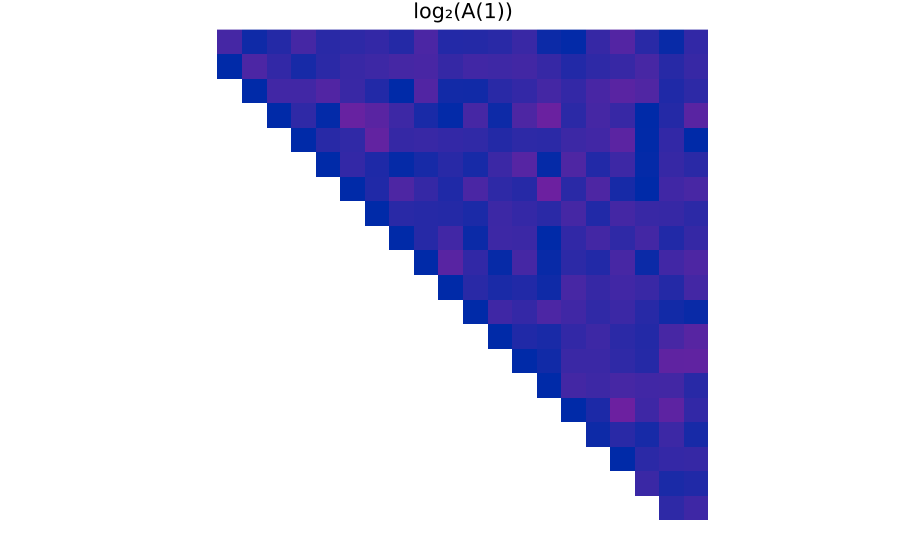

In [13]:
m = 20
A = randn(Complex{Float64},m,m)
n_iter = 200
Aᵢ = hessenberg(A).H
anim = Animation()
last = m
for i in 1:n_iter
    frame(anim,imshow(log2.(max.(abs.(Aᵢ), eps())), clim=(log2(eps()),1), colorbar=false, title="log₂(A($i))"))
    μ = Aᵢ[last,last]
    Q, R = qr(Aᵢ - I * μ)
    Aᵢ = R * Q + I * μ
end
gif(anim, "QR_demo_5.gif", fps=4)

Plots.AnimatedGif("/Users/lzs/Desktop/个人/CSE 6643 Numerical Linear Algebra/Lecture/QR_demo_6.gif")
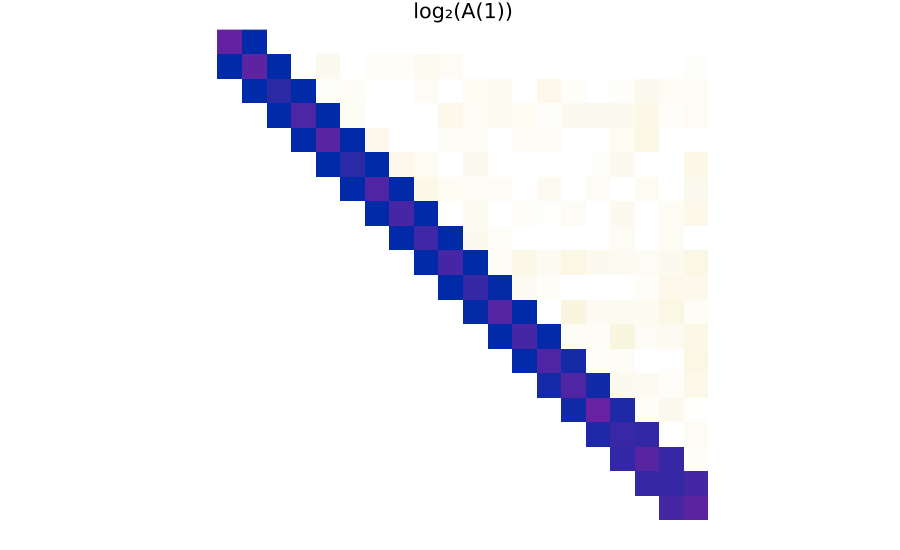

In [14]:
m = 20
A = randn(Complex{Float64},m,m)
A = 0.5 * (A + A')
n_iter = 200
Aᵢ = hessenberg(A).H
anim = Animation()
last = m
for i in 1:n_iter
    frame(anim,imshow(log2.(max.(abs.(Aᵢ), eps())), clim=(log2(eps()),1), colorbar=false, title="log₂(A($i))"))
    μ = Aᵢ[last,last]
    Q, R = qr(Aᵢ - I * μ)
    Aᵢ = Matrix(Tridiagonal(R * Q + I * μ))
end
gif(anim, "QR_demo_6.gif", fps=4)

### Sign an eigenvalue has converged: $A_{k,k-1} = 0$

- How to move on to the next eigenvalue after the first one has converged?

In [15]:
A⁽ⁱ⁾ = hessenberg(A).H
tol = 2 * eps()
k = m
for i in 1:n_iter
    μ = A⁽ⁱ⁾[k,k]
    Q⁽ⁱ⁾, R⁽ⁱ⁾ = qr(A⁽ⁱ⁾ - I * μ) # shift
    A⁽ⁱ⁾ = R⁽ⁱ⁾ * Q⁽ⁱ⁾ + I * μ
    if abs(A⁽ⁱ⁾[k,k-1]) < tol
        k = max(k-1,2)
    end
end

Plots.AnimatedGif("/Users/lzs/Desktop/个人/CSE 6643 Numerical Linear Algebra/Lecture/QR_demo_7.gif")
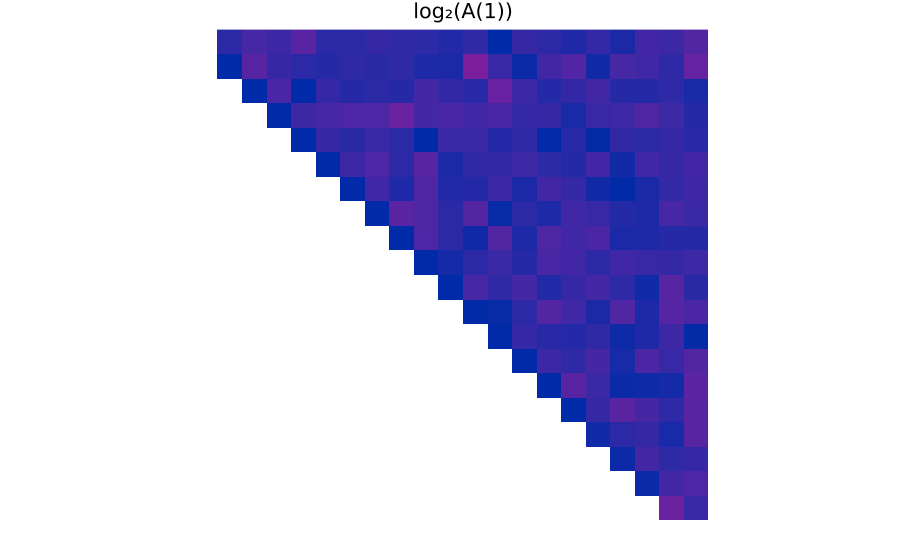

In [16]:
m = 20
A = randn(Complex{Float64},m,m)
n_iter = 200
Aᵢ = hessenberg(A).H
anim = Animation()
last = m
for i in 1:n_iter
    frame(anim,imshow(log2.(max.(abs.(Aᵢ), eps())), clim=(log2(eps()),1), colorbar=false, title="log₂(A($i))"))
    μ = Aᵢ[last,last]
    Q, R = qr(Aᵢ - I * μ)
    Aᵢ = R * Q + I * μ
    if abs(Aᵢ[last,last-1]) < 2 * eps()
        last = max(last-1, 2)
    end
end
gif(anim, "QR_demo_7.gif", fps=4)

Plots.AnimatedGif("/Users/lzs/Desktop/个人/CSE 6643 Numerical Linear Algebra/Lecture/QR_demo_8.gif")
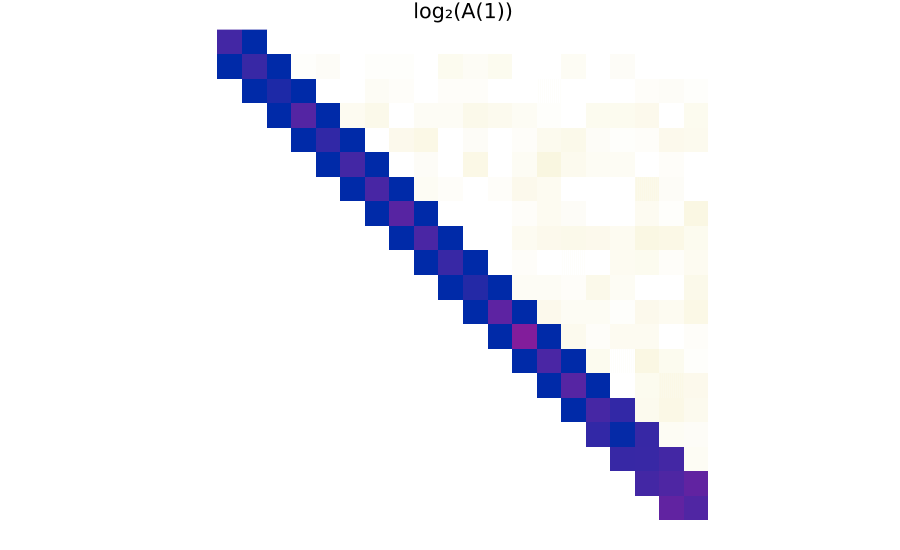

In [17]:
m = 20
A = randn(Complex{Float64},m,m)
A = 0.5 * (A + A')
n_iter = 200
Aᵢ = hessenberg(A).H
anim = Animation()
last = m
for i in 1:n_iter
    frame(anim,imshow(log2.(max.(abs.(Aᵢ), eps())), clim=(log2(eps()),1), colorbar=false, title="log₂(A($i))"))
    μ = Aᵢ[last,last]
    Q, R = qr(Aᵢ - I * μ)
    Aᵢ = Matrix(Tridiagonal(R * Q + I * μ))
    if abs(Aᵢ[last,last-1]) < 2 * eps()
        last = max(last-1, 2)
    end
end
gif(anim, "QR_demo_8.gif", fps=4)

### Deflation

If $A_{k,k-1}$ is close enough to zero, set it equal to zero to avoid noise reintroducing nonzeros.

In [18]:
A⁽ⁱ⁾ = hessenberg(A).H
tol = 2 * eps()
k = m
for i in 1:n_iter
    μ = A⁽ⁱ⁾[k,k]
    Q⁽ⁱ⁾, R⁽ⁱ⁾ = qr(A⁽ⁱ⁾ - I * μ) # shift
    A⁽ⁱ⁾ = R⁽ⁱ⁾ * Q⁽ⁱ⁾ + I * μ
    if abs(A⁽ⁱ⁾[k,k-1]) < tol
        A⁽ⁱ⁾[k,k-1] = 0 # deflation
        k = max(k-1,2)
    end
end

Plots.AnimatedGif("/Users/lzs/Desktop/个人/CSE 6643 Numerical Linear Algebra/Lecture/QR_demo_9.gif")
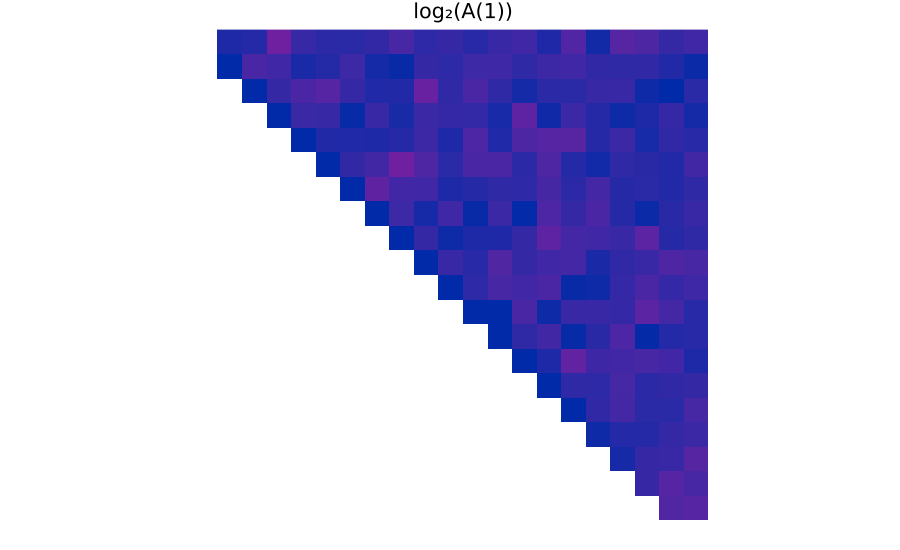

In [19]:
m = 20
A = randn(Complex{Float64},m,m)
n_iter = 200
Aᵢ = hessenberg(A).H
anim = Animation()
last = m
for i in 1:n_iter
    frame(anim,imshow(log2.(max.(abs.(Aᵢ), eps())), clim=(log2(eps()),1), colorbar=false, title="log₂(A($i))"))
    μ = Aᵢ[last,last]
    Q, R = qr(Aᵢ - I * μ)
    Aᵢ = R * Q + I * μ
    if abs(Aᵢ[last,last-1]) < 2 * eps()
        Aᵢ[last,last-1] = 0
        last = max(last-1, 2)
    end
end
gif(anim, "QR_demo_9.gif", fps=4)

Plots.AnimatedGif("/Users/lzs/Desktop/个人/CSE 6643 Numerical Linear Algebra/Lecture/QR_demo_10.gif")
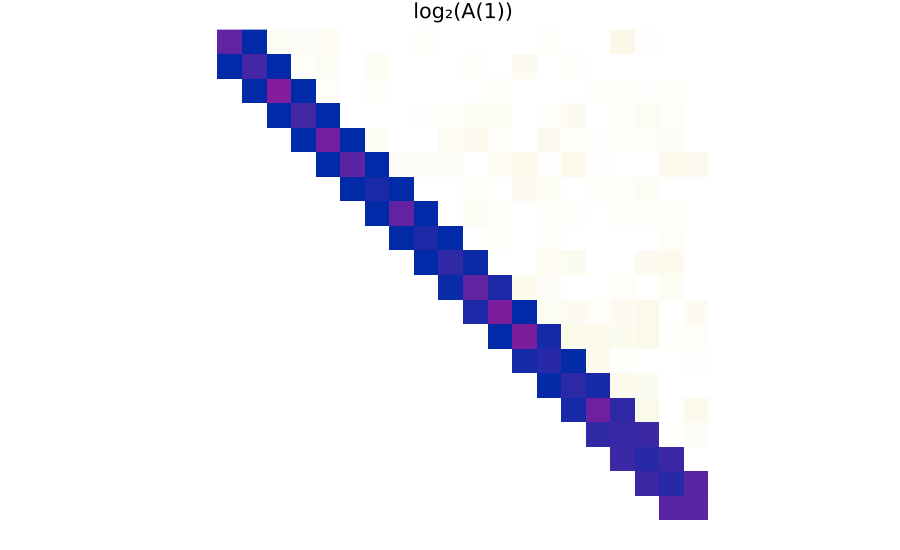

In [20]:
m = 20
A = randn(Complex{Float64},m,m)
A = 0.5 * (A + A')
n_iter = 200
Aᵢ = hessenberg(A).H
anim = Animation()
last = m
for i in 1:n_iter
    frame(anim,imshow(log2.(max.(abs.(Aᵢ), eps())), clim=(log2(eps()),1), colorbar=false, title="log₂(A($i))"))
    μ = Aᵢ[last,last]
    Q, R = qr(Aᵢ - I * μ)
    Aᵢ = Matrix(Tridiagonal(R * Q + I * μ))
    if abs(Aᵢ[last,last-1]) < 2 * eps()
        Aᵢ[last,last-1] = Aᵢ[last-1,last] = 0
        last = max(last-1, 2)
    end
end
gif(anim, "QR_demo_10.gif", fps=4)

### More robust shift: _Wilkinson shift_

In [21]:
A⁽ⁱ⁾ = hessenberg(A).H
tol = 2 * eps()
k = m
for i in 1:n_iter
    λs = eigvals(A⁽ⁱ⁾[k-1:k,k-1:k])
    μ = λs[1]
    if abs(λs[2] - A⁽ⁱ⁾[k,k]) < abs(λs[1] - A⁽ⁱ⁾[k,k])
        μ = λs[2]
    end
    Q⁽ⁱ⁾, R⁽ⁱ⁾ = qr(A⁽ⁱ⁾ - I * μ) # shift
    A⁽ⁱ⁾ = R⁽ⁱ⁾ * Q⁽ⁱ⁾ + I * μ
    if abs(A⁽ⁱ⁾[k,k-1]) < tol
        A⁽ⁱ⁾[k,k-1] = 0 # deflation
        k = max(k-1,2)
    end
end

Plots.AnimatedGif("/Users/lzs/Desktop/个人/CSE 6643 Numerical Linear Algebra/Lecture/QR_demo_11.gif")
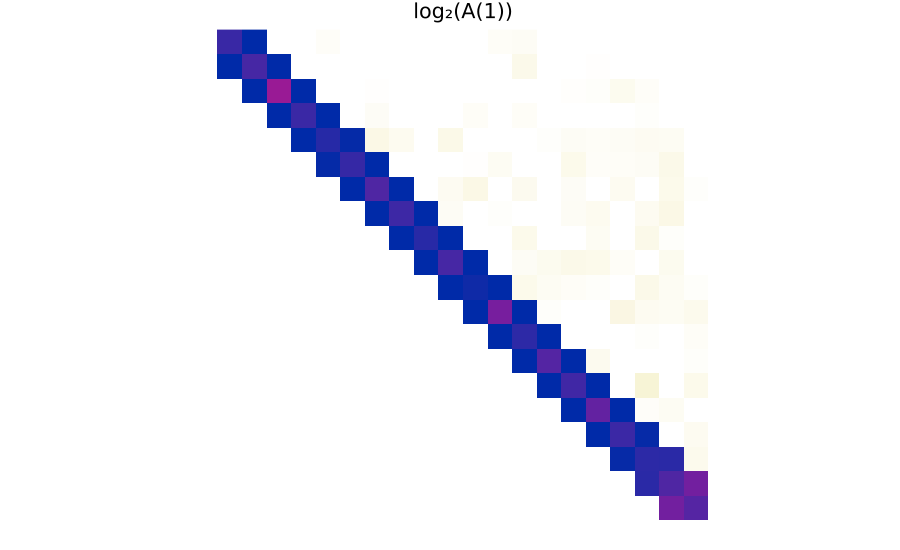

In [22]:
m = 20
A = randn(m,m)
A = 0.5 * (A + A')
n_iter = 200
Aᵢ = hessenberg(A).H
anim = Animation()
last = m
for i in 1:n_iter
    frame(anim,imshow(log2.(max.(abs.(Aᵢ), eps())), clim=(log2(eps()),1), colorbar=false, title="log₂(A($i))"))
    λs = eigvals(Aᵢ[last-1:last,last-1:last])
    μ = λs[1]
    if abs(λs[2] - Aᵢ[last,last]) < abs(λs[1] - Aᵢ[last,last])
        μ = λs[2]
    end
    μ = Aᵢ[last,last]
    Q, R = qr(Aᵢ - I * μ)
    Aᵢ = Matrix(Tridiagonal(R * Q + I * μ))
    if abs(Aᵢ[last,last-1]) < 2 * eps()
        Aᵢ[last,last-1] = Aᵢ[last-1,last] = 0
        last = max(last-1, 2)
    end
end
gif(anim, "QR_demo_11.gif", fps=4)

### Questions

- The diagonal converges to eigenvalues:

  - How fast without shifts?
  
  - How fast with shifts?
  
- $A^{(i)} \to T$: how to get $Q$ in $A = Q T Q^*$?

- How does it work?  What is going on?

## Simultaneous Iteration